# Data Visualization

Univariate Analysis

Non-Graphical Univariate Analysis

In [1]:
import numpy as np
import pandas as pd
import sys, os
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
sys.path.append(os.path.abspath(os.path.join('../scripts')))
from file_handler import FileHandler
from df_selector import *
from df_cleaner import *
from df_visualizer import *

In [3]:
# reading the store csv file
df = pd.read_csv("../data/merged_store.csv", low_memory=False)

df.head(4)

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,Year,...,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,CompetitionBeforeStoreOpened,PromoInterval0,PromoInterval1,PromoInterval2,PromoInterval3
0,1,5,2015-07-31,5263,555,1,1,0,1,2015,...,2008,0,0,0,"0,0,0,0",0,0,0,0,0
1,2,5,2015-07-31,6064,625,1,1,0,1,2015,...,2007,1,13,2010,"Jan,Apr,Jul,Oct",0,1,4,7,10
2,3,5,2015-07-31,8314,821,1,1,0,1,2015,...,2006,1,14,2011,"Jan,Apr,Jul,Oct",0,1,4,7,10
3,4,5,2015-07-31,13995,1498,1,1,0,1,2015,...,2009,0,0,0,"0,0,0,0",0,0,0,0,0


In [4]:
df.describe()

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Year,Month,DayOfMonth,...,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,CompetitionBeforeStoreOpened,PromoInterval0,PromoInterval1,PromoInterval2,PromoInterval3
count,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,...,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06
mean,5.584297e+02,3.998341e+00,5.773819e+03,6.331459e+02,8.301067e-01,3.815145e-01,1.786467e-01,2.013832e+03,5.846762e+00,1.570279e+01,...,5.244756e+00,1.974140e+03,5.005638e-01,1.164767e+01,1.007011e+03,3.178776e-01,8.087758e-01,2.310467e+00,3.812159e+00,5.313850e+00
std,3.219087e+02,1.997391e+00,3.849926e+03,4.644117e+02,3.755392e-01,4.857586e-01,3.830564e-01,7.773960e-01,3.326097e+00,8.787638e+00,...,3.928522e+00,5.085323e+01,4.999999e-01,1.532393e+01,1.005877e+03,4.656519e-01,9.811752e-01,2.374089e+00,3.848362e+00,5.336992e+00
min,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.013000e+03,1.000000e+00,1.000000e+00,...,1.000000e+00,1.900000e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.800000e+02,2.000000e+00,3.727000e+03,4.050000e+02,1.000000e+00,0.000000e+00,0.000000e+00,2.013000e+03,3.000000e+00,8.000000e+00,...,1.000000e+00,1.900000e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,5.580000e+02,4.000000e+00,5.744000e+03,6.090000e+02,1.000000e+00,0.000000e+00,0.000000e+00,2.014000e+03,6.000000e+00,1.600000e+01,...,4.000000e+00,2.006000e+03,1.000000e+00,1.000000e+00,2.009000e+03,0.000000e+00,1.000000e+00,4.000000e+00,7.000000e+00,1.000000e+01
75%,8.380000e+02,6.000000e+00,7.856000e+03,8.370000e+02,1.000000e+00,1.000000e+00,0.000000e+00,2.014000e+03,8.000000e+00,2.300000e+01,...,9.000000e+00,2.011000e+03,1.000000e+00,2.200000e+01,2.012000e+03,1.000000e+00,1.000000e+00,4.000000e+00,7.000000e+00,1.000000e+01
max,1.115000e+03,7.000000e+00,4.155100e+04,7.388000e+03,1.000000e+00,1.000000e+00,1.000000e+00,2.015000e+03,1.200000e+01,3.100000e+01,...,1.200000e+01,2.015000e+03,1.000000e+00,5.000000e+01,2.015000e+03,1.000000e+00,3.000000e+00,6.000000e+00,9.000000e+00,1.200000e+01


In [5]:
# unique value counts of store type

counts_df = df['StoreType'].value_counts()
counts_df

StoreType
a    551627
d    312912
c    136840
b     15830
Name: count, dtype: int64

In [6]:
plotly_plot_pie(df, 'StoreType')

Assortment

In [7]:
# unique value counts
counts_df = df['Assortment'].value_counts()
counts_df

Assortment
a    537445
c    471470
b      8294
Name: count, dtype: int64

In [8]:
plotly_plot_pie(df, 'Assortment')

CompetitionDistance

In [9]:
plotly_plot_hist(df, 'CompetitionDistance')

Promo2

In [10]:
# unique value counts
counts_df = df['Promo2'].value_counts()
counts_df

Promo2
1    509178
0    508031
Name: count, dtype: int64

CompetitionBeforeStoreOpened

In [11]:
# unique value counts
counts_df = df['CompetitionBeforeStoreOpened'].value_counts()
counts_df

CompetitionBeforeStoreOpened
0    693861
1    323348
Name: count, dtype: int64

DayOfWeek

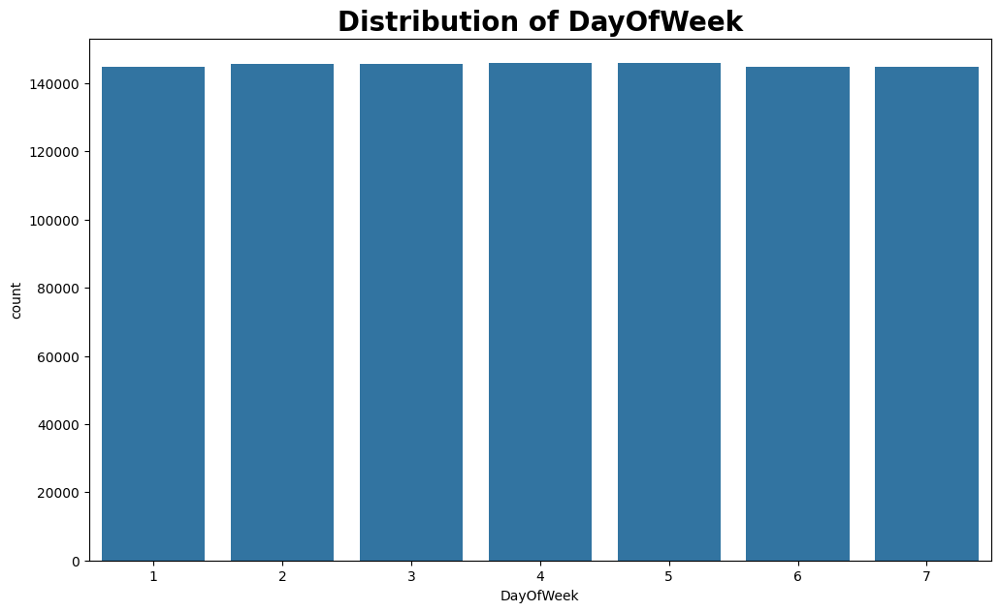

In [12]:
plot_count(df, 'DayOfWeek')

Sales

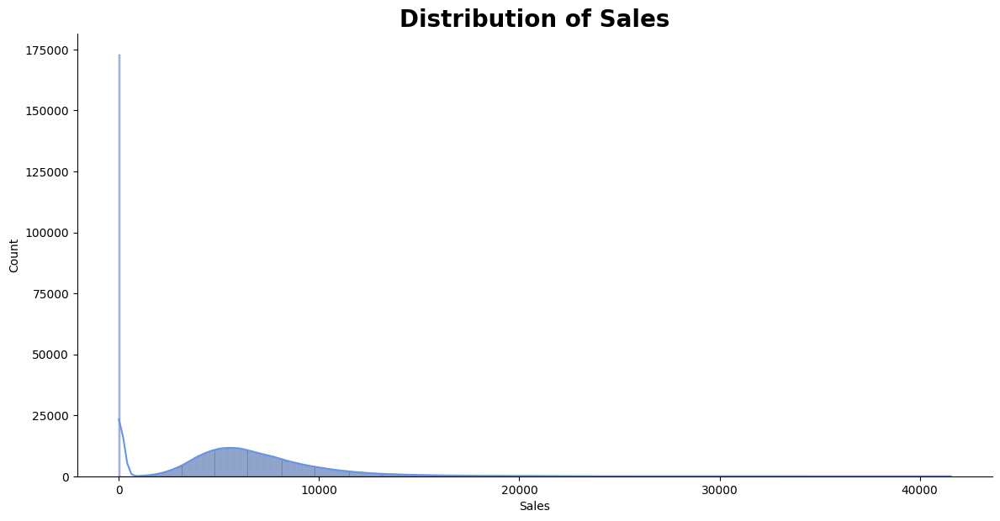

In [13]:
plot_hist(df, 'Sales')

Customers

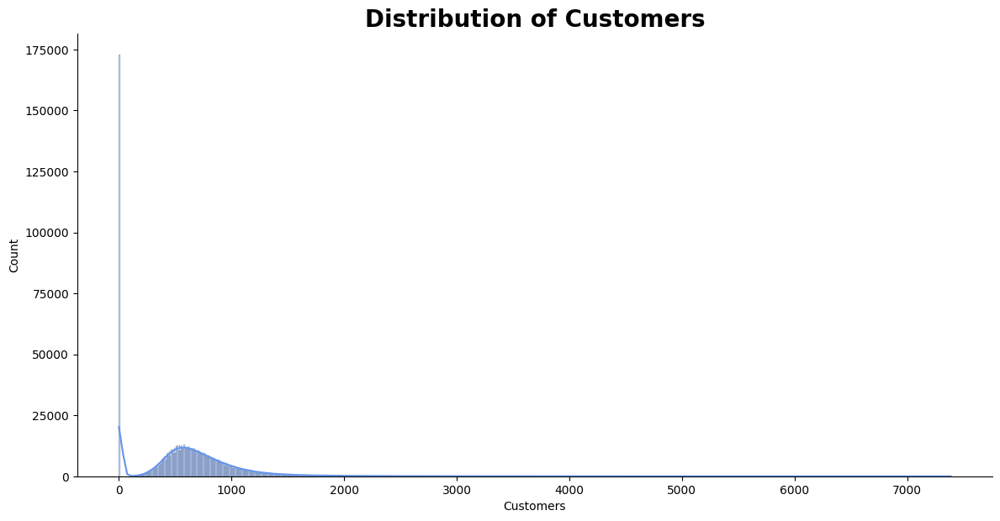

In [14]:
plot_hist(df, 'Customers')

Open

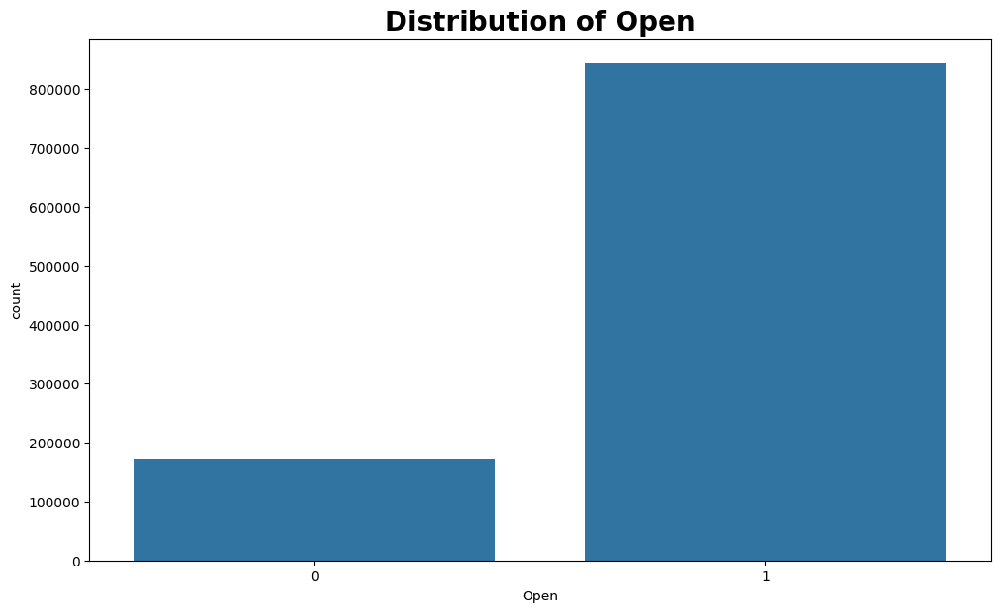

In [15]:
plot_count(df, 'Open')

Promo

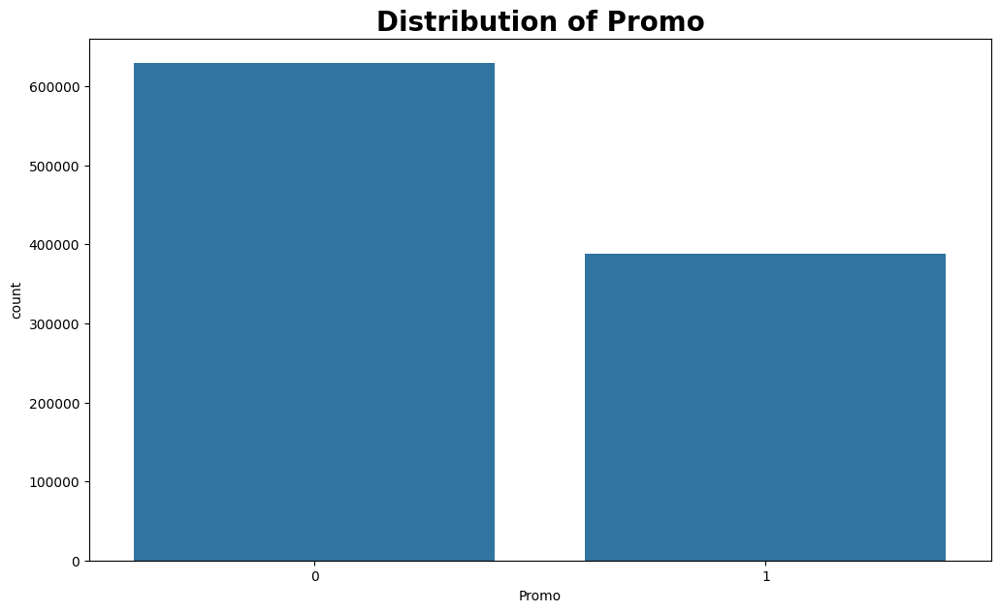

In [16]:
plot_count(df, 'Promo')

StateHoliday

In [17]:
# unique value counts
counts_df = df['StateHoliday'].value_counts()
counts_df

StateHoliday
0    986159
a     20260
b      6690
c      4100
Name: count, dtype: int64

SchoolHoliday

In [18]:
# unique value counts
counts_df = df['SchoolHoliday'].value_counts()
counts_df

SchoolHoliday
0    835488
1    181721
Name: count, dtype: int64